<a href="https://colab.research.google.com/github/KOMPALALOKESH/project-practice/blob/main/data_wrangling.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# data wrangling

In [ ]:
import pandas as pd
import random as rd

In [ ]:
pd.set_option("display.max_columns",None)
pd.set_option("display.max_rows",None)

In [ ]:
data = {"id":[str(i) for i in range(1,201)],
        "salary":[rd.randint(50000,100000) for i in range(200)],
        "age":[str(rd.randint(25,40)) for i in range(200)]
       }
for i in range(30):
    data["salary"][rd.randint(0,200)]=None
    data["age"][rd.randint(0,200)]=None
data = pd.DataFrame(data)
display(data)

,id,salary,age
0,1,58092.0,27
1,2,62257.0,31
2,3,71045.0,40
3,4,NaN,39
4,5,81293.0,34
5,6,NaN,None
6,7,83282.0,29
7,8,NaN,None
8,9,NaN,26
9,10,71760.0,38


In [ ]:
print(type(data))
print("basic info of df:\n",data.info())
print("statistical info of df:\n",data.describe())

<class 'pandas.core.frame.DataFrame'>
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 200 entries, 0 to 199
Data columns (total 3 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   id      200 non-null    object 
 1   salary  171 non-null    float64
 2   age     171 non-null    object 
dtypes: float64(1), object(2)
memory usage: 4.8+ KB
basic info of df:
 None
statistical info of df:
              salary
count    171.000000
mean   74164.432749
std    14073.639360
min    51258.000000
25%    60934.000000
50%    74470.000000
75%    85845.500000
max    99912.000000


In [ ]:
print("columnwise statistical info of df:",data["salary"].describe())

columnwise statistical info of df: count      171.000000
mean     74164.432749
std      14073.639360
min      51258.000000
25%      60934.000000
50%      74470.000000
75%      85845.500000
max      99912.000000
Name: salary, dtype: float64


## regex in pandas 

## caution: regex do not work with None/NaN df

In [ ]:
regex = "3.*"
data[data.id.str.match(regex)]

,id,salary,age
2,3,71045.0,40
29,30,60783.0,40
30,31,59513.0,26
31,32,74989.0,30
32,33,78797.0,40
33,34,62814.0,32
34,35,NaN,40
35,36,70925.0,28
36,37,66290.0,37
37,38,90105.0,29


In [ ]:
data.head(2)

,id,salary,age
0,1,58092.0,27
1,2,62257.0,31


In [ ]:
data.tail()

,id,salary,age
195,196,79712.0,34
196,197,NaN,29
197,198,67715.0,26
198,199,63938.0,30
199,200,69617.0,37


## handling missing values

In [ ]:
data.isnull()
print(data.isnull().sum())

id         0
salary    29
age       29
dtype: int64


In [ ]:
data["salary"].isnull()

0      False
1      False
2      False
3       True
4      False
5       True
6      False
7       True
8       True
9      False
10     False
11     False
12     False
13     False
14     False
15     False
16     False
17     False
18     False
19     False
20     False
21     False
22     False
23     False
24     False
25     False
26     False
27     False
28     False
29     False
30     False
31     False
32     False
33     False
34      True
35     False
36     False
37     False
38     False
39     False
40      True
41     False
42      True
43     False
44     False
45     False
46     False
47     False
48     False
49     False
50     False
51     False
52     False
53     False
54      True
55     False
56      True
57      True
58     False
59     False
60      True
61     False
62      True
63     False
64     False
65     False
66      True
67     False
68     False
69     False
70     False
71     False
72     False
73     False
74     False
75     False
76      True

In [ ]:
df = pd.read_csv('Human_Resources.csv')
display(df.describe())
display(df)

,Age,MonthlyIncome,DailyRate,DistanceFromHome,Education,EmployeeCount,EmployeeNumber,EnvironmentSatisfaction,HourlyRate,JobInvolvement,JobLevel,JobSatisfaction,MonthlyRate,NumCompaniesWorked,PercentSalaryHike,PerformanceRating,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
count,1470.000000,1467.000000,1470.000000,1470.000000,1470.000000,1470.0,1469.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1468.000000,1470.000000,1469.000000,1469.000000,1470.000000,1470.0,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000
mean,36.923810,6505.155419,802.485714,9.192517,2.912925,1.0,1025.556161,2.721769,65.891156,2.729932,2.063946,2.728571,14310.966621,2.693197,15.206263,3.153165,2.712245,80.0,0.793878,11.279592,2.799320,2.761224,7.008163,4.229252,2.187755,4.123129
std,9.135373,4711.297846,403.509100,8.106864,1.024165,0.0,601.646166,1.093082,20.329428,0.711561,1.106940,1.102846,7121.294449,2.498009,3.659047,0.360270,1.081209,0.0,0.852077,7.780782,1.289271,0.706476,6.126525,3.623137,3.222430,3.568136
min,18.000000,1009.000000,102.000000,1.000000,1.000000,1.0,1.000000,1.000000,30.000000,1.000000,1.000000,1.000000,2094.000000,0.000000,11.000000,3.000000,1.000000,80.0,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000
25%,30.000000,2911.000000,465.000000,2.000000,2.000000,1.0,492.000000,2.000000,48.000000,2.000000,1.000000,2.000000,8043.750000,1.000000,12.000000,3.000000,2.000000,80.0,0.000000,6.000000,2.000000,2.000000,3.000000,2.000000,0.000000,2.000000
50%,36.000000,4908.000000,802.000000,7.000000,3.000000,1.0,1022.000000,3.000000,66.000000,3.000000,2.000000,3.000000,14235.500000,2.000000,14.000000,3.000000,3.000000,80.0,1.000000,10.000000,3.000000,3.000000,5.000000,3.000000,1.000000,3.000000
75%,43.000000,8378.000000,1157.000000,14.000000,4.000000,1.0,1556.000000,4.000000,83.750000,3.000000,3.000000,4.000000,20463.250000,4.000000,18.000000,3.000000,4.000000,80.0,1.000000,15.000000,3.000000,3.000000,9.000000,7.000000,3.000000,7.000000
max,60.000000,19999.000000,1499.000000,29.000000,5.000000,1.0,2068.000000,4.000000,100.000000,4.000000,5.000000,4.000000,26999.000000,9.000000,25.000000,4.000000,4.000000,80.0,3.000000,40.000000,6.000000,4.000000,40.000000,18.000000,15.000000,17.000000


,Age,MonthlyIncome,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,EnvironmentSatisfaction,Gender,HourlyRate,JobInvolvement,JobLevel,JobRole,JobSatisfaction,MaritalStatus,MonthlyRate,NumCompaniesWorked,Over18,OverTime,PercentSalaryHike,PerformanceRating,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,41,5993.0,Yes,Travel_Rarely,1102,Sales,1,2,Life Sciences,1,1.0,2,Female,94,3,2,Sales Executive,4,Single,19479.0,8,Y,Yes,11.0,3.0,1,80,0,8,0,1,6,4,0,5
1,49,NaN,No,Travel_Frequently,279,Research & Development,8,1,Life Sciences,1,2.0,3,Male,61,2,2,Research Scientist,2,Married,24907.0,1,Y,No,23.0,4.0,4,80,1,10,3,3,10,7,1,7
2,37,2090.0,Yes,Travel_Rarely,1373,Research & Development,2,2,Other,1,4.0,4,Male,92,2,1,Laboratory Technician,3,Single,2396.0,6,Y,Yes,15.0,3.0,2,80,0,7,3,3,0,0,0,0
3,33,2909.0,No,Travel_Frequently,1392,Research & Development,3,4,Life Sciences,1,5.0,4,Female,56,3,1,Research Scientist,3,Married,23159.0,1,Y,Yes,11.0,3.0,3,80,0,8,3,3,8,7,3,0
4,27,3468.0,No,Travel_Rarely,591,Research & Development,2,1,Medical,1,7.0,1,Male,40,3,1,Laboratory Technician,2,Married,16632.0,9,Y,No,12.0,3.0,4,80,1,6,3,3,2,2,2,2
5,32,3068.0,No,Travel_Frequently,1005,Research & Development,2,2,Life Sciences,1,8.0,4,Male,79,3,1,Laboratory Technician,4,Single,11864.0,0,Y,No,13.0,3.0,3,80,0,8,2,2,7,7,3,6
6,59,NaN,No,Travel_Rarely,1324,Research & Development,3,3,NaN,1,NaN,3,NaN,81,4,1,NaN,1,Married,9964.0,4,Y,Yes,NaN,NaN,1,80,3,12,3,2,1,0,0,0
7,30,2693.0,No,Travel_Rarely,1358,NaN,24,1,Life Sciences,1,11.0,4,Male,67,3,1,Laboratory Technician,3,Divorced,13335.0,1,Y,No,22.0,4.0,2,80,1,1,2,3,1,0,0,0
8,38,9526.0,No,Travel_Frequently,216,Research & Development,23,3,Life Sciences,1,12.0,4,Male,44,2,3,Manufacturing Director,3,Single,8787.0,0,Y,No,21.0,4.0,2,80,0,10,2,3,9,7,1,8
9,36,5237.0,No,Travel_Rarely,1299,Research & Development,27,3,Medical,1,13.0,3,Male,94,3,2,Healthcare Representative,3,Married,16577.0,6,Y,No,13.0,3.0,2,80,2,17,3,2,7,7,7,7


In [ ]:
df.isnull()

,Age,MonthlyIncome,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,EnvironmentSatisfaction,Gender,HourlyRate,JobInvolvement,JobLevel,JobRole,JobSatisfaction,MaritalStatus,MonthlyRate,NumCompaniesWorked,Over18,OverTime,PercentSalaryHike,PerformanceRating,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
1,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
2,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
3,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
4,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
5,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
6,False,True,False,False,False,False,False,False,True,False,True,False,True,False,False,False,True,False,False,False,False,False,False,True,True,False,False,False,False,False,False,False,False,False,False
7,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
8,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
9,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False


In [ ]:
df.isnull().sum()

Age                         0
MonthlyIncome               3
Attrition                   0
BusinessTravel              0
DailyRate                   0
Department                  1
DistanceFromHome            0
Education                   0
EducationField              1
EmployeeCount               0
EmployeeNumber              1
EnvironmentSatisfaction     0
Gender                      1
HourlyRate                  0
JobInvolvement              0
JobLevel                    0
JobRole                     1
JobSatisfaction             0
MaritalStatus               1
MonthlyRate                 2
NumCompaniesWorked          0
Over18                      0
OverTime                    0
PercentSalaryHike           1
PerformanceRating           1
RelationshipSatisfaction    0
StandardHours               0
StockOptionLevel            0
TotalWorkingYears           0
TrainingTimesLastYear       0
WorkLifeBalance             0
YearsAtCompany              0
YearsInCurrentRole          0
YearsSince

## deleting rows contains None/NaN

In [ ]:
#DataFrame.dropna(*, axis=0, how=_NoDefault.no_default, thresh=_NoDefault.no_default, subset=None, inplace=False)
df.dropna(axis = 0,how='any',thresh=4,subset=["MonthlyIncome","EducationField"])
df

,Age,MonthlyIncome,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,EnvironmentSatisfaction,Gender,HourlyRate,JobInvolvement,JobLevel,JobRole,JobSatisfaction,MaritalStatus,MonthlyRate,NumCompaniesWorked,Over18,OverTime,PercentSalaryHike,PerformanceRating,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,41,5993.0,Yes,Travel_Rarely,1102,Sales,1,2,Life Sciences,1,1.0,2,Female,94,3,2,Sales Executive,4,Single,19479.0,8,Y,Yes,11.0,3.0,1,80,0,8,0,1,6,4,0,5
1,49,NaN,No,Travel_Frequently,279,Research & Development,8,1,Life Sciences,1,2.0,3,Male,61,2,2,Research Scientist,2,Married,24907.0,1,Y,No,23.0,4.0,4,80,1,10,3,3,10,7,1,7
2,37,2090.0,Yes,Travel_Rarely,1373,Research & Development,2,2,Other,1,4.0,4,Male,92,2,1,Laboratory Technician,3,Single,2396.0,6,Y,Yes,15.0,3.0,2,80,0,7,3,3,0,0,0,0
3,33,2909.0,No,Travel_Frequently,1392,Research & Development,3,4,Life Sciences,1,5.0,4,Female,56,3,1,Research Scientist,3,Married,23159.0,1,Y,Yes,11.0,3.0,3,80,0,8,3,3,8,7,3,0
4,27,3468.0,No,Travel_Rarely,591,Research & Development,2,1,Medical,1,7.0,1,Male,40,3,1,Laboratory Technician,2,Married,16632.0,9,Y,No,12.0,3.0,4,80,1,6,3,3,2,2,2,2
5,32,3068.0,No,Travel_Frequently,1005,Research & Development,2,2,Life Sciences,1,8.0,4,Male,79,3,1,Laboratory Technician,4,Single,11864.0,0,Y,No,13.0,3.0,3,80,0,8,2,2,7,7,3,6
6,59,NaN,No,Travel_Rarely,1324,Research & Development,3,3,NaN,1,NaN,3,NaN,81,4,1,NaN,1,Married,9964.0,4,Y,Yes,NaN,NaN,1,80,3,12,3,2,1,0,0,0
7,30,2693.0,No,Travel_Rarely,1358,NaN,24,1,Life Sciences,1,11.0,4,Male,67,3,1,Laboratory Technician,3,Divorced,13335.0,1,Y,No,22.0,4.0,2,80,1,1,2,3,1,0,0,0
8,38,9526.0,No,Travel_Frequently,216,Research & Development,23,3,Life Sciences,1,12.0,4,Male,44,2,3,Manufacturing Director,3,Single,8787.0,0,Y,No,21.0,4.0,2,80,0,10,2,3,9,7,1,8
9,36,5237.0,No,Travel_Rarely,1299,Research & Development,27,3,Medical,1,13.0,3,Male,94,3,2,Healthcare Representative,3,Married,16577.0,6,Y,No,13.0,3.0,2,80,2,17,3,2,7,7,7,7


In [ ]:
df.isnull().sum()

Age                         0
MonthlyIncome               3
Attrition                   0
BusinessTravel              0
DailyRate                   0
Department                  1
DistanceFromHome            0
Education                   0
EducationField              1
EmployeeCount               0
EmployeeNumber              1
EnvironmentSatisfaction     0
Gender                      1
HourlyRate                  0
JobInvolvement              0
JobLevel                    0
JobRole                     1
JobSatisfaction             0
MaritalStatus               1
MonthlyRate                 2
NumCompaniesWorked          0
Over18                      0
OverTime                    0
PercentSalaryHike           1
PerformanceRating           1
RelationshipSatisfaction    0
StandardHours               0
StockOptionLevel            0
TotalWorkingYears           0
TrainingTimesLastYear       0
WorkLifeBalance             0
YearsAtCompany              0
YearsInCurrentRole          0
YearsSince

In [ ]:
df["MonthlyIncome"].fillna(df["MonthlyIncome"].mean(),inplace=True)
display(df)

,Age,MonthlyIncome,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,EnvironmentSatisfaction,Gender,HourlyRate,JobInvolvement,JobLevel,JobRole,JobSatisfaction,MaritalStatus,MonthlyRate,NumCompaniesWorked,Over18,OverTime,PercentSalaryHike,PerformanceRating,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,41,5993.000000,Yes,Travel_Rarely,1102,Sales,1,2,Life Sciences,1,1.0,2,Female,94,3,2,Sales Executive,4,Single,19479.0,8,Y,Yes,11.0,3.0,1,80,0,8,0,1,6,4,0,5
1,49,6505.155419,No,Travel_Frequently,279,Research & Development,8,1,Life Sciences,1,2.0,3,Male,61,2,2,Research Scientist,2,Married,24907.0,1,Y,No,23.0,4.0,4,80,1,10,3,3,10,7,1,7
2,37,2090.000000,Yes,Travel_Rarely,1373,Research & Development,2,2,Other,1,4.0,4,Male,92,2,1,Laboratory Technician,3,Single,2396.0,6,Y,Yes,15.0,3.0,2,80,0,7,3,3,0,0,0,0
3,33,2909.000000,No,Travel_Frequently,1392,Research & Development,3,4,Life Sciences,1,5.0,4,Female,56,3,1,Research Scientist,3,Married,23159.0,1,Y,Yes,11.0,3.0,3,80,0,8,3,3,8,7,3,0
4,27,3468.000000,No,Travel_Rarely,591,Research & Development,2,1,Medical,1,7.0,1,Male,40,3,1,Laboratory Technician,2,Married,16632.0,9,Y,No,12.0,3.0,4,80,1,6,3,3,2,2,2,2
5,32,3068.000000,No,Travel_Frequently,1005,Research & Development,2,2,Life Sciences,1,8.0,4,Male,79,3,1,Laboratory Technician,4,Single,11864.0,0,Y,No,13.0,3.0,3,80,0,8,2,2,7,7,3,6
6,59,6505.155419,No,Travel_Rarely,1324,Research & Development,3,3,NaN,1,NaN,3,NaN,81,4,1,NaN,1,Married,9964.0,4,Y,Yes,NaN,NaN,1,80,3,12,3,2,1,0,0,0
7,30,2693.000000,No,Travel_Rarely,1358,NaN,24,1,Life Sciences,1,11.0,4,Male,67,3,1,Laboratory Technician,3,Divorced,13335.0,1,Y,No,22.0,4.0,2,80,1,1,2,3,1,0,0,0
8,38,9526.000000,No,Travel_Frequently,216,Research & Development,23,3,Life Sciences,1,12.0,4,Male,44,2,3,Manufacturing Director,3,Single,8787.0,0,Y,No,21.0,4.0,2,80,0,10,2,3,9,7,1,8
9,36,5237.000000,No,Travel_Rarely,1299,Research & Development,27,3,Medical,1,13.0,3,Male,94,3,2,Healthcare Representative,3,Married,16577.0,6,Y,No,13.0,3.0,2,80,2,17,3,2,7,7,7,7


In [ ]:
print(df["MonthlyIncome"].median())

4933.0


In [ ]:
df = pd.read_csv("Human_Resources.csv")
df["EducationField"].unique()

array(['Life Sciences', 'Other', 'Medical', nan, 'Marketing',
       'Technical Degree', 'Human Resources'], dtype=object)

## Convert categorical data to numeric data (One Hot Encoding)

In [ ]:
dummy = pd.get_dummies(df["EducationField"],dummy_na=True)
dummy

,Human Resources,Life Sciences,Marketing,Medical,Other,Technical Degree,NaN
0,0,1,0,0,0,0,0
1,0,1,0,0,0,0,0
2,0,0,0,0,1,0,0
3,0,1,0,0,0,0,0
4,0,0,0,1,0,0,0
5,0,1,0,0,0,0,0
6,0,0,0,0,0,0,1
7,0,1,0,0,0,0,0
8,0,1,0,0,0,0,0
9,0,0,0,1,0,0,0


In [ ]:
df.drop("EducationField",axis = 1)

,Age,MonthlyIncome,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EmployeeCount,EmployeeNumber,EnvironmentSatisfaction,Gender,HourlyRate,JobInvolvement,JobLevel,JobRole,JobSatisfaction,MaritalStatus,MonthlyRate,NumCompaniesWorked,Over18,OverTime,PercentSalaryHike,PerformanceRating,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,41,5993.0,Yes,Travel_Rarely,1102,Sales,1,2,1,1.0,2,Female,94,3,2,Sales Executive,4,Single,19479.0,8,Y,Yes,11.0,3.0,1,80,0,8,0,1,6,4,0,5
1,49,NaN,No,Travel_Frequently,279,Research & Development,8,1,1,2.0,3,Male,61,2,2,Research Scientist,2,Married,24907.0,1,Y,No,23.0,4.0,4,80,1,10,3,3,10,7,1,7
2,37,2090.0,Yes,Travel_Rarely,1373,Research & Development,2,2,1,4.0,4,Male,92,2,1,Laboratory Technician,3,Single,2396.0,6,Y,Yes,15.0,3.0,2,80,0,7,3,3,0,0,0,0
3,33,2909.0,No,Travel_Frequently,1392,Research & Development,3,4,1,5.0,4,Female,56,3,1,Research Scientist,3,Married,23159.0,1,Y,Yes,11.0,3.0,3,80,0,8,3,3,8,7,3,0
4,27,3468.0,No,Travel_Rarely,591,Research & Development,2,1,1,7.0,1,Male,40,3,1,Laboratory Technician,2,Married,16632.0,9,Y,No,12.0,3.0,4,80,1,6,3,3,2,2,2,2
5,32,3068.0,No,Travel_Frequently,1005,Research & Development,2,2,1,8.0,4,Male,79,3,1,Laboratory Technician,4,Single,11864.0,0,Y,No,13.0,3.0,3,80,0,8,2,2,7,7,3,6
6,59,NaN,No,Travel_Rarely,1324,Research & Development,3,3,1,NaN,3,NaN,81,4,1,NaN,1,Married,9964.0,4,Y,Yes,NaN,NaN,1,80,3,12,3,2,1,0,0,0
7,30,2693.0,No,Travel_Rarely,1358,NaN,24,1,1,11.0,4,Male,67,3,1,Laboratory Technician,3,Divorced,13335.0,1,Y,No,22.0,4.0,2,80,1,1,2,3,1,0,0,0
8,38,9526.0,No,Travel_Frequently,216,Research & Development,23,3,1,12.0,4,Male,44,2,3,Manufacturing Director,3,Single,8787.0,0,Y,No,21.0,4.0,2,80,0,10,2,3,9,7,1,8
9,36,5237.0,No,Travel_Rarely,1299,Research & Development,27,3,1,13.0,3,Male,94,3,2,Healthcare Representative,3,Married,16577.0,6,Y,No,13.0,3.0,2,80,2,17,3,2,7,7,7,7


In [ ]:
pd.concat([df,dummy])

,Age,MonthlyIncome,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,EnvironmentSatisfaction,Gender,HourlyRate,JobInvolvement,JobLevel,JobRole,JobSatisfaction,MaritalStatus,MonthlyRate,NumCompaniesWorked,Over18,OverTime,PercentSalaryHike,PerformanceRating,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager,Human Resources,Life Sciences,Marketing,Medical,Other,Technical Degree,NaN
0,41.0,5993.0,Yes,Travel_Rarely,1102.0,Sales,1.0,2.0,Life Sciences,1.0,1.0,2.0,Female,94.0,3.0,2.0,Sales Executive,4.0,Single,19479.0,8.0,Y,Yes,11.0,3.0,1.0,80.0,0.0,8.0,0.0,1.0,6.0,4.0,0.0,5.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,49.0,NaN,No,Travel_Frequently,279.0,Research & Development,8.0,1.0,Life Sciences,1.0,2.0,3.0,Male,61.0,2.0,2.0,Research Scientist,2.0,Married,24907.0,1.0,Y,No,23.0,4.0,4.0,80.0,1.0,10.0,3.0,3.0,10.0,7.0,1.0,7.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,37.0,2090.0,Yes,Travel_Rarely,1373.0,Research & Development,2.0,2.0,Other,1.0,4.0,4.0,Male,92.0,2.0,1.0,Laboratory Technician,3.0,Single,2396.0,6.0,Y,Yes,15.0,3.0,2.0,80.0,0.0,7.0,3.0,3.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,33.0,2909.0,No,Travel_Frequently,1392.0,Research & Development,3.0,4.0,Life Sciences,1.0,5.0,4.0,Female,56.0,3.0,1.0,Research Scientist,3.0,Married,23159.0,1.0,Y,Yes,11.0,3.0,3.0,80.0,0.0,8.0,3.0,3.0,8.0,7.0,3.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,27.0,3468.0,No,Travel_Rarely,591.0,Research & Development,2.0,1.0,Medical,1.0,7.0,1.0,Male,40.0,3.0,1.0,Laboratory Technician,2.0,Married,16632.0,9.0,Y,No,12.0,3.0,4.0,80.0,1.0,6.0,3.0,3.0,2.0,2.0,2.0,2.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,32.0,3068.0,No,Travel_Frequently,1005.0,Research & Development,2.0,2.0,Life Sciences,1.0,8.0,4.0,Male,79.0,3.0,1.0,Laboratory Technician,4.0,Single,11864.0,0.0,Y,No,13.0,3.0,3.0,80.0,0.0,8.0,2.0,2.0,7.0,7.0,3.0,6.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,59.0,NaN,No,Travel_Rarely,1324.0,Research & Development,3.0,3.0,NaN,1.0,NaN,3.0,NaN,81.0,4.0,1.0,NaN,1.0,Married,9964.0,4.0,Y,Yes,NaN,NaN,1.0,80.0,3.0,12.0,3.0,2.0,1.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7,30.0,2693.0,No,Travel_Rarely,1358.0,NaN,24.0,1.0,Life Sciences,1.0,11.0,4.0,Male,67.0,3.0,1.0,Laboratory Technician,3.0,Divorced,13335.0,1.0,Y,No,22.0,4.0,2.0,80.0,1.0,1.0,2.0,3.0,1.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8,38.0,9526.0,No,Travel_Frequently,216.0,Research & Development,23.0,3.0,Life Sciences,1.0,12.0,4.0,Male,44.0,2.0,3.0,Manufacturing Director,3.0,Single,8787.0,0.0,Y,No,21.0,4.0,2.0,80.0,0.0,10.0,2.0,3.0,9.0,7.0,1.0,8.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9,36.0,5237.0,No,Travel_Rarely,1299.0,Research & Development,27.0,3.0,Medical,1.0,13.0,3.0,Male,94.0,3.0,2.0,Healthcare Representative,3.0,Married,16577.0,6.0,Y,No,13.0,3.0,2.0,80.0,2.0,17.0,3.0,2.0,7.0,7.0,7.0,7.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN


## feature scaling

In [ ]:
from sklearn.preprocessing import MinMaxScaler,StandardScaler
Normalization = MinMaxScaler()
df['Age'] = Normalization.fit_transform(df['Age'].values.reshape(-1,1))
df['Age'].describe().round(2)

count    1470.00
mean        0.45
std         0.22
min         0.00
25%         0.29
50%         0.43
75%         0.60
max         1.00
Name: Age, dtype: float64

In [ ]:
Standardization = StandardScaler()
df['Age'] = Standardization.fit_transform(df['Age'].values.reshape(-1,1))
df['Age'].describe().round(2)

count    1470.00
mean        0.00
std         1.00
min        -2.07
25%        -0.76
50%        -0.10
75%         0.67
max         2.53
Name: Age, dtype: float64

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7fcaa4cf7910>,
      dtype=object)

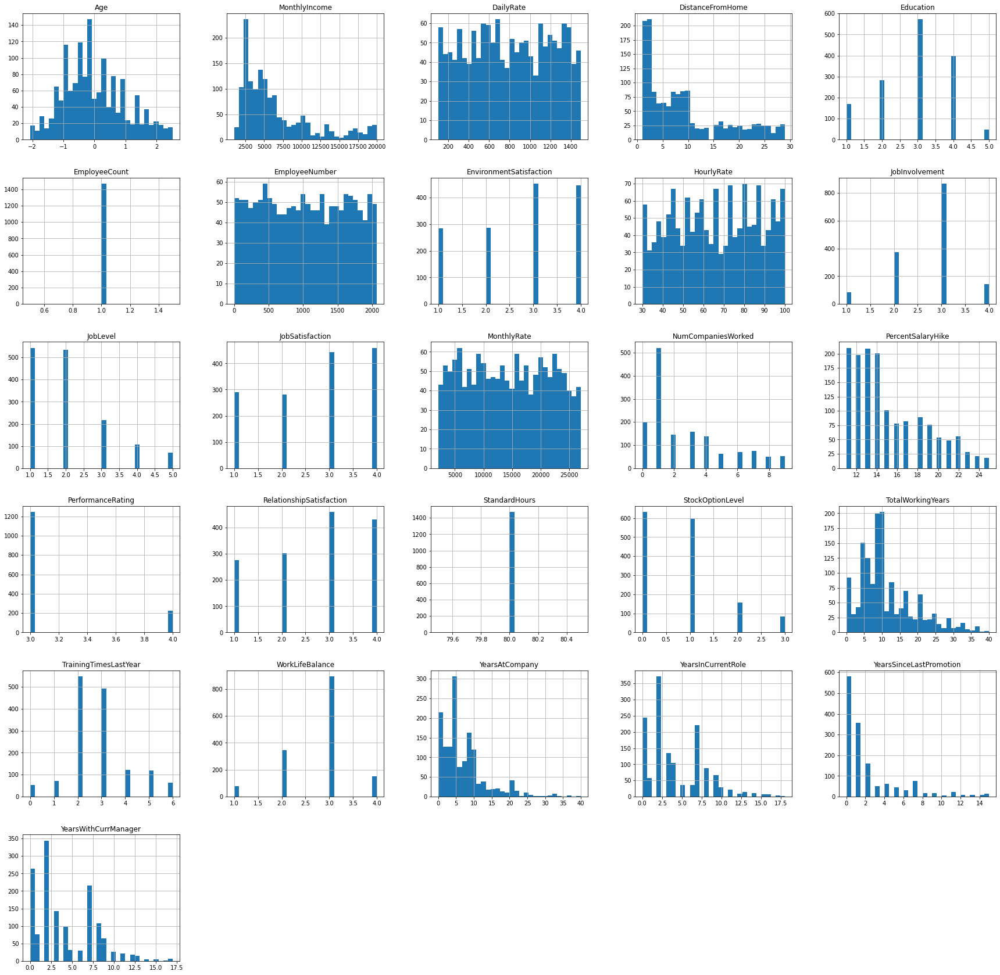

In [ ]:
df.hist(bins=30,figsize=(30,30))